In [1]:
import math 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

In [2]:
#dataset = pd.read_csv('./cleaned_df.csv')
dataset = pd.read_csv('./cleaned_df.csv', keep_default_na=False) #Avoid 'null' in CSV to be parsed as NaN 
dataset.describe()

,price,year,odometer
count,83003.000000,83003.000000,83003.000000
mean,13516.885438,2011.128610,103821.619303
std,8970.604066,5.800385,61473.967556
min,1050.000000,1981.000000,0.000000
25%,6499.000000,2007.000000,54000.000000
50%,11500.000000,2012.000000,99748.000000
75%,18448.000000,2016.000000,144200.000000
max,40712.000000,2021.000000,410374.000000


In [3]:
dataset.head(3)

,price,year,model,condition,cylinders,fuel,odometer,transmission,drive,type,paint_color,state
0,13995,2012.0,f-150,good,6 cylinders,gas,188406.0,automatic,4wd,truck,grey,mn
1,7995,2010.0,equinox,good,4 cylinders,gas,108124.0,automatic,4wd,SUV,grey,mn
2,8995,2011.0,traverse,good,6 cylinders,gas,178054.0,automatic,4wd,SUV,white,mn


In [4]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83003 entries, 0 to 83002
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   price         83003 non-null  int64  
 1   year          83003 non-null  float64
 2   model         83003 non-null  object 
 3   condition     83003 non-null  object 
 4   cylinders     83003 non-null  object 
 5   fuel          83003 non-null  object 
 6   odometer      83003 non-null  float64
 7   transmission  83003 non-null  object 
 8   drive         83003 non-null  object 
 9   type          83003 non-null  object 
 10  paint_color   83003 non-null  object 
 11  state         83003 non-null  object 
dtypes: float64(2), int64(1), object(9)
memory usage: 7.6+ MB


## Individual Variable Description   

## Price

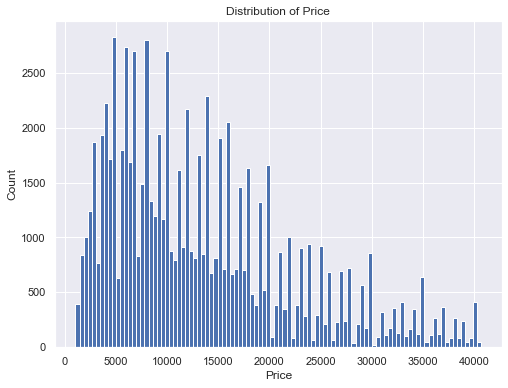

In [5]:
fig, ax = plt.subplots(figsize=(8,6))
ax.hist(dataset['price'], 100)
ax.set_title('Distribution of Price'), ax.set_xlabel('Price'), ax.set_ylabel('Count')
fig.show()

## Year

In [6]:
dataset['year'].mean()

2011.128609809284

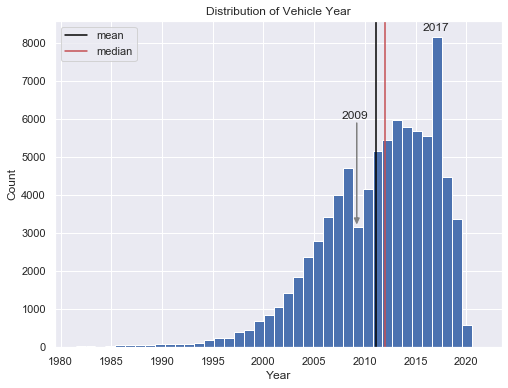

In [7]:
fig, ax = plt.subplots(figsize=(8,6))
ax.hist(dataset['year'], len(dataset['year'].value_counts()), align='right')
ax.set_title('Distribution of Vehicle Year'), ax.set_xlabel('Year'), ax.set_ylabel('Count')
ax.arrow(2009.2,5900,0,-2500,head_width=0.5,head_length=150,color='gray')
ax.axvline(x=dataset['year'].mean(),color='black',label='mean')
ax.axvline(x=dataset['year'].median(),color='r',label='median')
ax.text(2017,8300,'2017',horizontalalignment='center')
ax.text(2009,6000,'2009',horizontalalignment='center')
ax.legend()
fig.show()

## Model

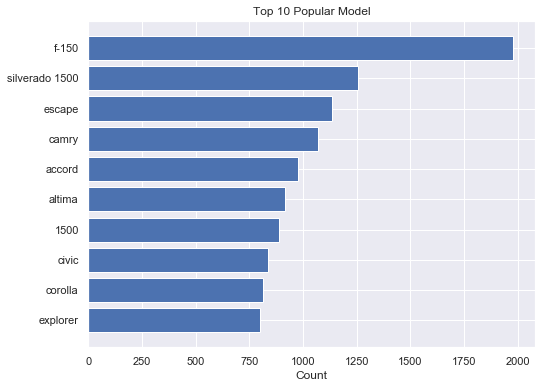

In [8]:
fig, ax = plt.subplots(figsize=(8,6))
ax.barh(dataset['model'].value_counts().iloc[:10].index, dataset['model'].value_counts().iloc[:10].values)
ax.set_title('Top 10 Popular Model'), ax.set_xlabel('Count'), ax.invert_yaxis()
fig.show()

## Condition

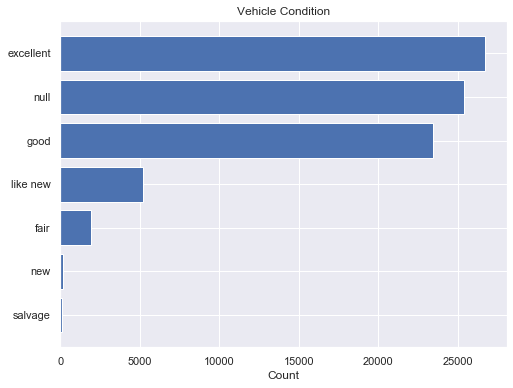

In [9]:
fig, ax = plt.subplots(figsize=(8,6))
ax.barh(dataset['condition'].value_counts().index, dataset['condition'].value_counts().values)
ax.set_title('Vehicle Condition'), ax.set_xlabel('Count'), ax.invert_yaxis()
fig.show()

Clearly, a large amount (25416) of vehicle condition are not reported in this dataset.

## Engine Cylinder Count

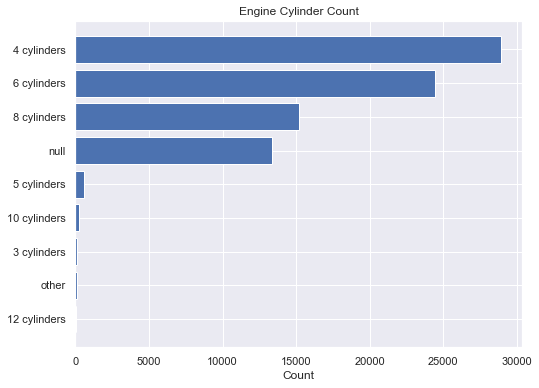

In [10]:
fig, ax = plt.subplots(figsize=(8,6))
ax.barh(dataset['cylinders'].value_counts().index, dataset['cylinders'].value_counts().values)
ax.set_title('Engine Cylinder Count'), ax.set_xlabel('Count'), ax.invert_yaxis()
fig.show()

## Fuel Type

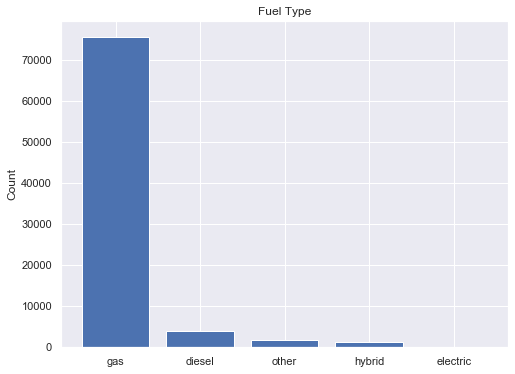

In [11]:
fig, ax = plt.subplots(figsize=(8,6))
ax.bar(dataset['fuel'].value_counts().index, dataset['fuel'].value_counts().values)
ax.set_title('Fuel Type'), ax.set_ylabel('Count')
fig.show()

## Mileage

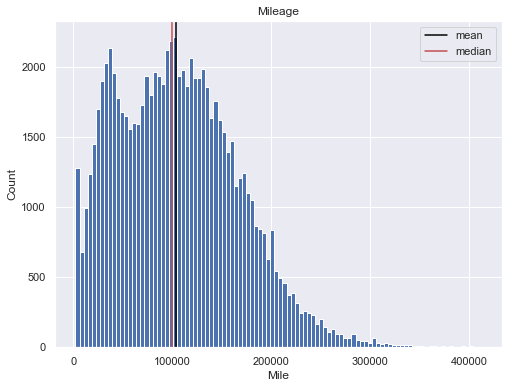

In [12]:
fig, ax = plt.subplots(figsize=(8,6))
ax.hist(dataset['odometer'], 100, align='right')
ax.set_title('Mileage'), ax.set_xlabel('Mile'), ax.set_ylabel('Count')
ax.axvline(x=dataset['odometer'].mean(),color='black',label='mean')
ax.axvline(x=dataset['odometer'].median(),color='r',label='median')
ax.legend()
fig.show()

## Transmission

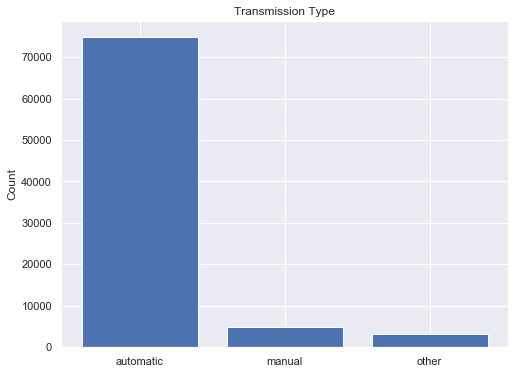

In [13]:
fig, ax = plt.subplots(figsize=(8,6))
ax.bar(dataset['transmission'].value_counts().index, dataset['transmission'].value_counts().values)
ax.set_title('Transmission Type'), ax.set_ylabel('Count')
fig.show()

## Drive

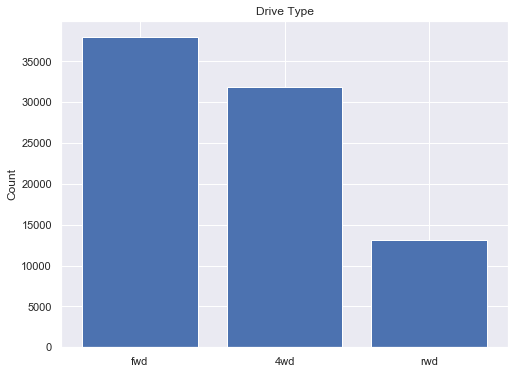

In [14]:
fig, ax = plt.subplots(figsize=(8,6))
ax.bar(dataset['drive'].value_counts().index, dataset['drive'].value_counts().values)
ax.set_title('Drive Type'), ax.set_ylabel('Count')
fig.show()

## Vehicle Type

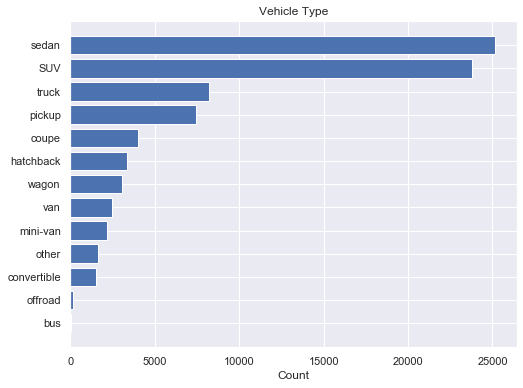

In [15]:
fig, ax = plt.subplots(figsize=(8,6))
ax.barh(dataset['type'].value_counts().index, dataset['type'].value_counts().values)
ax.set_title('Vehicle Type'), ax.set_xlabel('Count'), ax.invert_yaxis()
fig.show()

## Paint Color

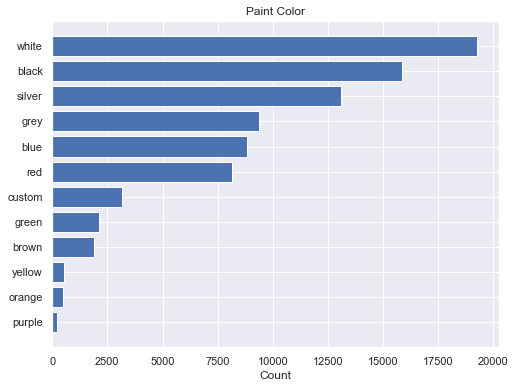

In [16]:
fig, ax = plt.subplots(figsize=(8,6))
ax.barh(dataset['paint_color'].value_counts().index, dataset['paint_color'].value_counts().values)
ax.set_title('Paint Color'), ax.set_xlabel('Count'), ax.invert_yaxis()
fig.show()

## State

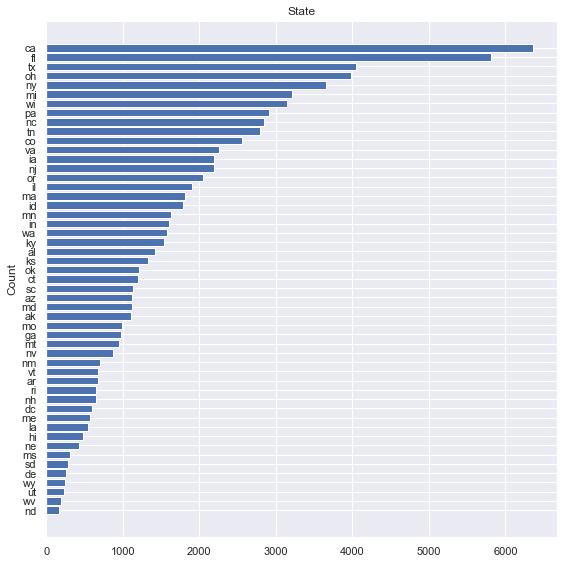

In [17]:
fig, ax = plt.subplots(figsize=(8,8))
ax.barh(dataset['state'].value_counts().index, dataset['state'].value_counts().values)
ax.set_title('State'), ax.set_ylabel('Count'), ax.invert_yaxis()
fig.tight_layout()
fig.show()

# Multivariate Analysis

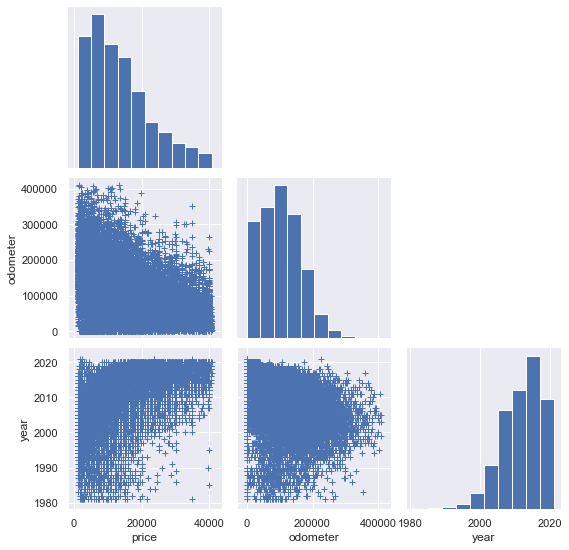

In [18]:
sns.pairplot(pd.concat([dataset.price,dataset.odometer,dataset.year], axis=1),              corner=True, plot_kws=dict(marker="+", linewidth=1))
plt.show() 

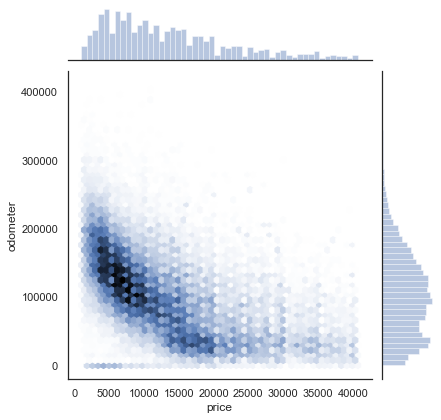

In [19]:
with sns.axes_style('white'):
    sns.jointplot('price', 'odometer', dataset, kind='hex')

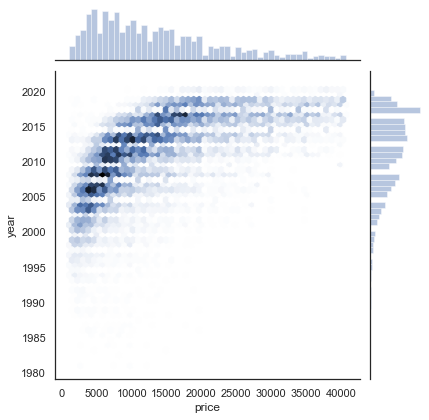

In [20]:
with sns.axes_style('white'):
    sns.jointplot('price', 'year', dataset, kind='hex')

In [21]:
#sns.regplot('odometer','price',dataset)

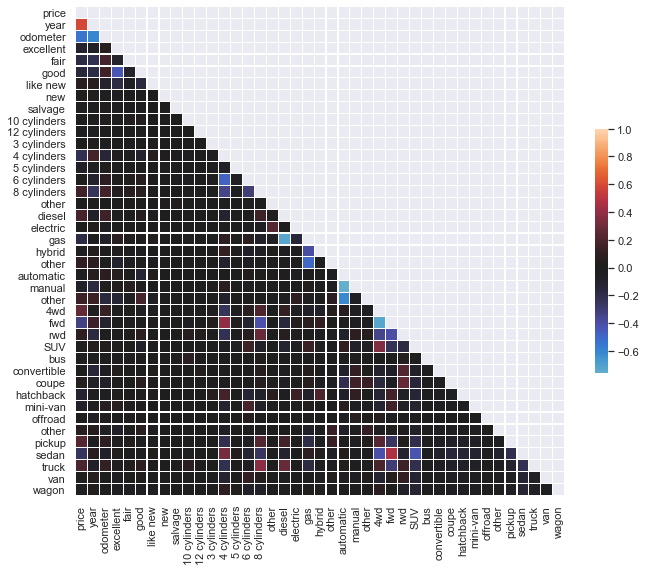

In [22]:
dd = pd.concat([dataset,pd.get_dummies(dataset.condition)], axis=1)
dd = dd.drop(columns=['null'])
dd = pd.concat([dd,pd.get_dummies(dataset.cylinders)], axis=1)
dd = dd.drop(columns=['null'])
dd = pd.concat([dd,pd.get_dummies(dataset.fuel)], axis=1)
dd = pd.concat([dd,pd.get_dummies(dataset.transmission)], axis=1)
dd = pd.concat([dd,pd.get_dummies(dataset.drive)], axis=1)
dd = pd.concat([dd,pd.get_dummies(dataset.type)], axis=1)
#dd = pd.concat([dd,pd.get_dummies(dataset.paint_color)], axis=1)

corr = dd.corr()
fig, ax = plt.subplots(figsize=(11, 9))
sns.heatmap(corr, mask=np.triu(np.ones_like(corr, dtype=bool)), center=0,
            square=True, linewidths=.1, cbar_kws={"shrink": .5})
fig.show()

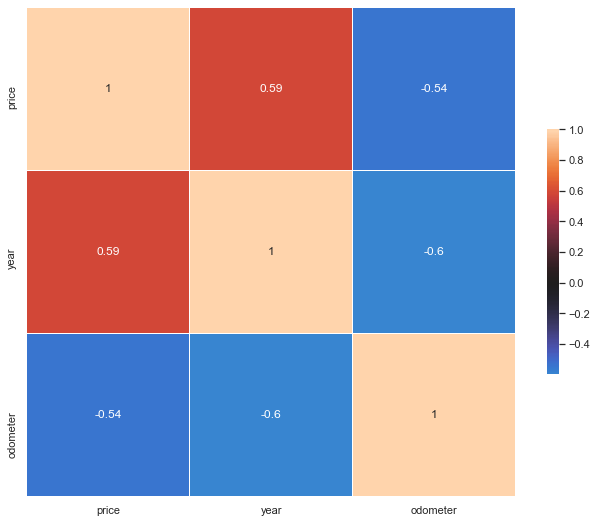

In [23]:
corr = dataset.corr()
fig, ax = plt.subplots(figsize=(11, 9))
sns.heatmap(corr, center=0, annot=True,
            square=True, linewidths=.1, cbar_kws={"shrink": .5})
fig.show()

In [24]:
dataset.head(3)

,price,year,model,condition,cylinders,fuel,odometer,transmission,drive,type,paint_color,state
0,13995,2012.0,f-150,good,6 cylinders,gas,188406.0,automatic,4wd,truck,grey,mn
1,7995,2010.0,equinox,good,4 cylinders,gas,108124.0,automatic,4wd,SUV,grey,mn
2,8995,2011.0,traverse,good,6 cylinders,gas,178054.0,automatic,4wd,SUV,white,mn


## Price and Odometer vs. Condition

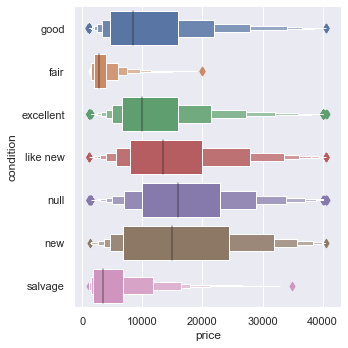

In [25]:
sns.catplot(x='price',y='condition',data=dataset[['price','condition']],                   kind='boxen')
plt.show()

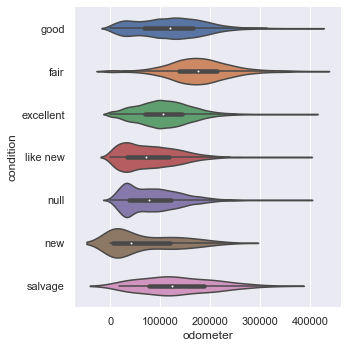

In [26]:
sns.catplot(x='odometer',y='condition',data=dataset[['odometer','condition']],             kind='violin')
plt.show()

## Price vs. Vehicle Type

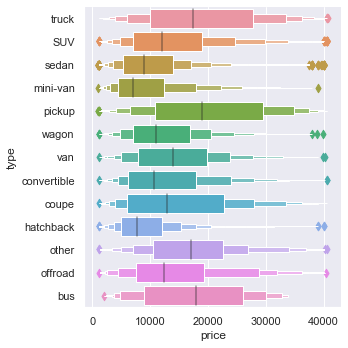

In [27]:
sns.catplot(x='price',y='type',data=dataset[['price','type']],                             kind='boxen')
plt.show()

## Price vs. Transmission, Drive, Cylinders and Fuel Type

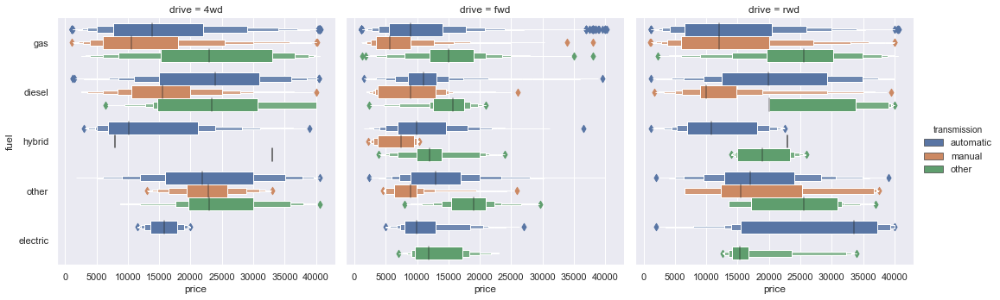

In [28]:
sns.catplot(x='price',y='fuel',col='drive',hue='transmission',
            data=dataset[['price','transmission','drive','fuel']],kind='boxen')
plt.show()

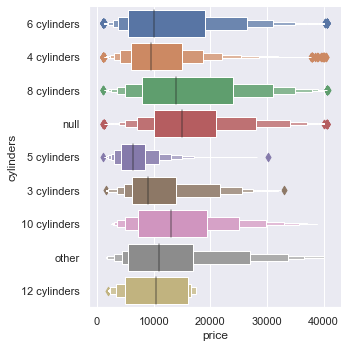

In [29]:
sns.catplot(x='price',y='cylinders',data=dataset[['price','cylinders']],               kind='boxen')
plt.show()

## Price vs. Paint Color

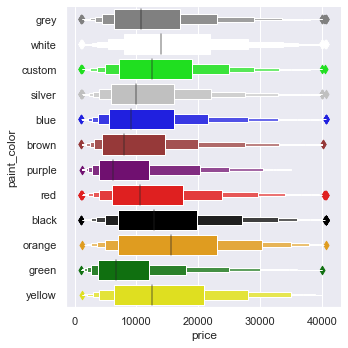

In [30]:
sns.catplot(x='price',y='paint_color',data=dataset[['price','paint_color']],               kind='boxen',palette=sns.color_palette(['gray','white','lime','silver','blue','brown','purple','red','black','orange','green','yellow']))
plt.show()